In [48]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
import pandas as pd
import os
import numpy as np
from pyTsetlinMachine.tm import MultiClassTsetlinMachine
from time import time
from PIL import Image
from sklearn.model_selection import train_test_split

In [50]:
from tzetlin import (filename_to_bin_img_array, get_img_array, filter_uneven_shapes,
                     load_lesion_df, get_all_imgs_filenames_from_dir_list, filter_non_lesion_entries, 
                     get_lesion_filenames_list,
                     split_lesions_present_absent,
                     find_duplicates)

## Dataset

In [51]:
PRUNED_DATASET_DIR = "data/Dataset-pruned"
PRUNED_IMGS_DIR = PRUNED_DATASET_DIR + "/base_images"

In [75]:
df = load_lesion_df()
print("Original df shape:", df.shape)

lesions_present_df, lesions_absent_df = split_lesions_present_absent(df)

lesion_filenames = get_lesion_filenames_list(df)
print("Num. of lesion files:", len(lesion_filenames))

lesions_present_df_filenames = get_lesion_filenames_list(lesions_present_df)
print("Num. of lesion files with lesion present (entry present in the csv):", 
      len(lesions_present_df_filenames))

lesions_absent_df_filenames = get_lesion_filenames_list(lesions_absent_df)
print("Num. of lesion files with lesion absent (entry absent in the csv):", 
      len(lesions_absent_df_filenames))

all_filenames = get_all_imgs_filenames_from_dir_list(PRUNED_IMGS_DIR)
print("Num. of all image files:", len(all_filenames))

Original df shape: (1149, 31)
Num. of lesion files: 1149
Num. of lesion files with lesion present (entry present in the csv): 620
Num. of lesion files with lesion absent (entry absent in the csv): 529
Num. of all image files: 931


In [76]:
dir_lesions_present = []
dir_lesions_absent = []
other = []

for f in all_filenames:
    if f in lesions_present_df_filenames:
        dir_lesions_present.append(f)
    elif f in lesions_absent_df_filenames:
        dir_lesions_absent.append(f)
    else:
        other.append(f)

print("Images present in the image folder, absent in the csv:", len(other))
dir_lesions_absent += other

Images present in the image folder, absent in the csv: 57


In [78]:
all_imgs = dir_lesions_present + dir_lesions_absent
len(all_imgs)

Y_train = [1]*len(dir_lesions_present) + [0]*len(dir_lesions_absent)

assert len(all_imgs) == len(Y_train)

In [80]:
# Separate image IDs and frame numbers
imgs_frames = []

for f in all_imgs:
    base = f.replace('.png','')
    img_id, frame = base.split('_')
    imgs_frames.append((img_id, frame))
len(imgs_frames)

931

In [81]:
img_size = (256, 256)
lesion_masks = []


for img_id, frame in imgs_frames:
    frame = int(frame)
    row = df[(df['image_id'] == img_id) & (df['frame'] == frame)]

    if row.empty:
        print(f"WARNING: No entry in df for {img_id}, frame {frame}")
        lesion_masks.append(np.zeros(img_size, dtype=np.uint8))
        continue
    elif pd.isna(row.iloc[0]['lesion_id']):
        print(f"WARNING: No lesion for {img_id}, frame {frame}")
        lesion_masks.append(np.zeros(img_size, dtype=np.uint8))
        continue

    lesion_x = int(row.iloc[0]['lesion_x'])
    lesion_y = int(row.iloc[0]['lesion_y'])
    lesion_width = int(row.iloc[0]['lesion_width'])
    lesion_height = int(row.iloc[0]['lesion_height'])

    lesion_mask = np.zeros(img_size, dtype=np.uint8)
    lesion_mask[lesion_y:lesion_y+lesion_height, lesion_x:lesion_x+lesion_width] = 1

    lesion_masks.append(lesion_mask)

lesion_masks = np.array(lesion_masks)
len(lesion_masks)

931

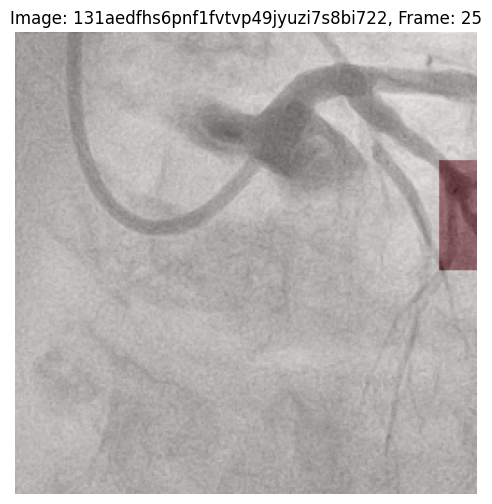

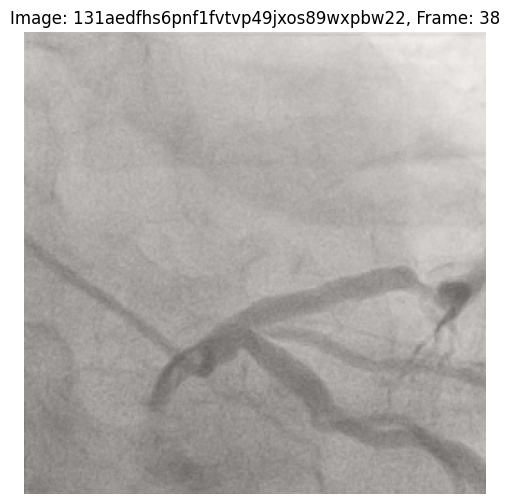

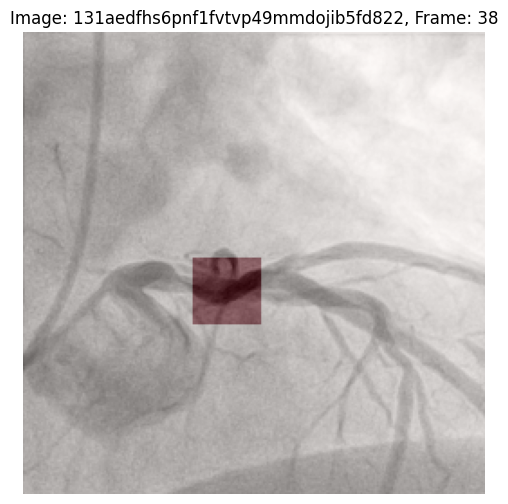

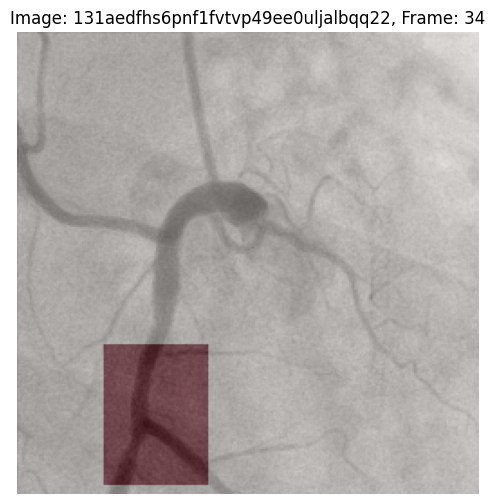

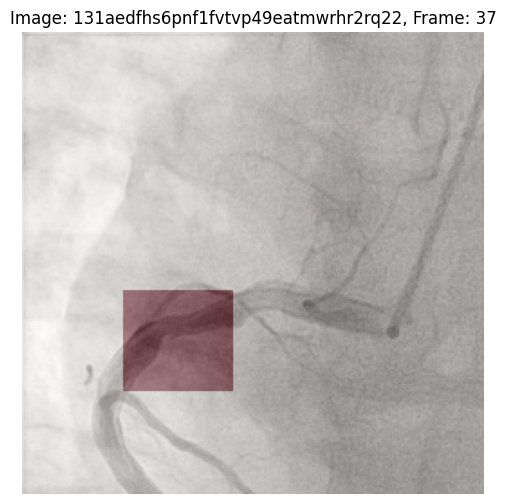

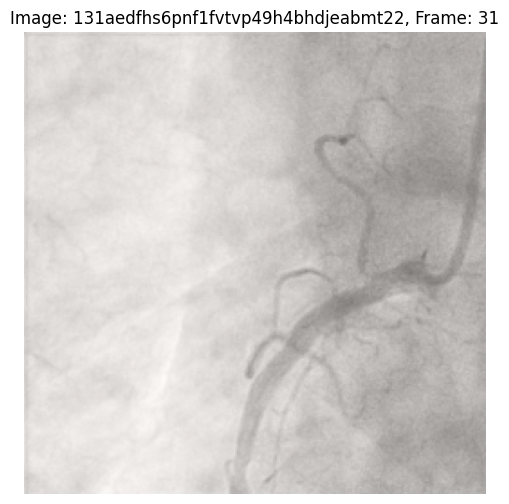

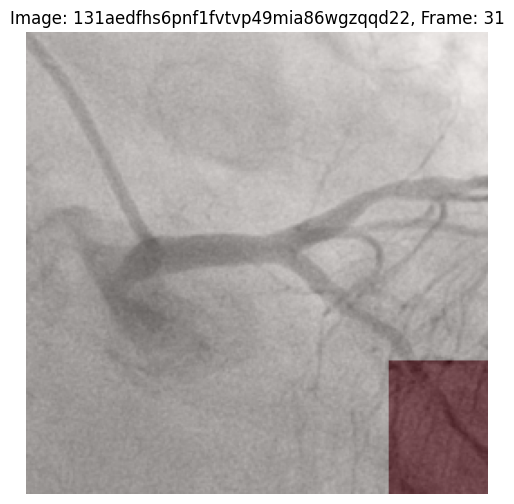

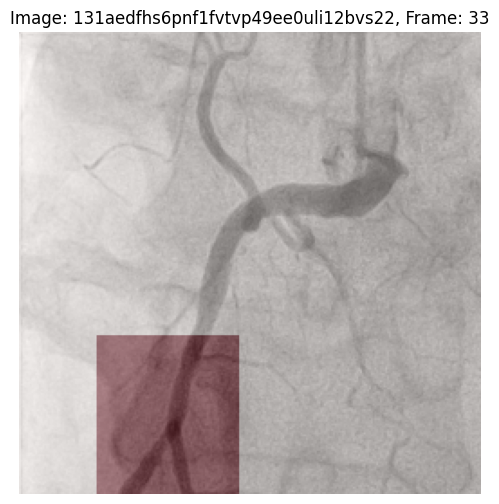

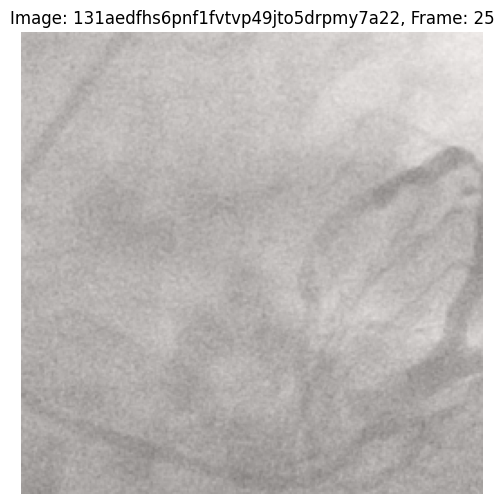

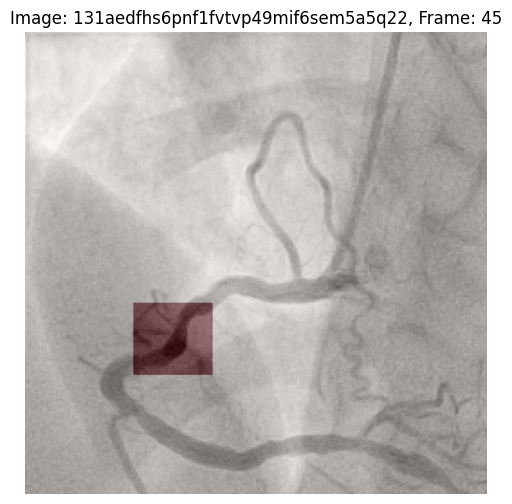

In [82]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image


DEFAULT_IMG_SIZE = (512, 512)

n_show = 10

for i, (img_id, frame) in enumerate(imgs_frames[:n_show]):
    img_path = os.path.join(PRUNED_IMGS_DIR, f"{img_id}_{frame}.png")
    img = Image.open(img_path).convert("L")  # grayscale
    img = img.resize(DEFAULT_IMG_SIZE, Image.NEAREST)
    img_arr = np.array(img)

    mask = lesion_masks[i]

    plt.figure(figsize=(6,6))
    plt.imshow(img_arr, cmap='gray')
    
    plt.imshow(mask, cmap='Reds', alpha=0.4)
    
    plt.title(f"Image: {img_id}, Frame: {frame}")
    plt.axis("off")
    plt.show()


In [83]:
all_imgs = [PRUNED_IMGS_DIR + "/" + img for img in all_imgs]

imgs_size = (256, 256)

img_array = get_img_array(all_imgs, size=imgs_size)
imgs_filtered = filter_uneven_shapes(img_array, img_size_standard=imgs_size)

In [84]:
X = imgs_filtered
y = Y_train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Convert to types accepted by pyTsetlinMachine (0/1 uint8)
X_train = X_train.astype(np.uint8)
X_test  = X_test.astype(np.uint8)

## Lesion presence/absence prediction - MultiClassTsetlinMachine

In [ ]:
from pyTsetlinMachine.tm import MultiClassTsetlinMachine

tm = MultiClassTsetlinMachine(
    number_of_clauses=200,
    T=50,
    s=5.0,
    weighted_clauses=True
)

epochs = 200

t0 = time()
tm.fit(X_train, y_train, epochs=epochs)
t1 = time()
print(f"Training done in {t1-t0:.1f}s")

y_pred = tm.predict(X_test)
acc = np.mean(y_pred == y_test)
print(f"Test accuracy: {acc*100:.2f}%")

### MultiClassConvolutionalTsetlinMachine2D

### Patches

In [ ]:
import numpy as np
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d

patch_size = (8, 8)
max_patches_per_image = 100

X_patches_list = []
y_labels_list = []

images = imgs_filtered
masks = lesion_masks

for img, mask in zip(images, masks):
    # Extract random patches from this image (if more patches than max_pathes)
    X_patches = extract_patches_2d(img, patch_size) #, max_patches=max_patches_per_image)
    Y_patches = extract_patches_2d(mask, patch_size) #, max_patches=max_patches_per_image)

    # Label each patch: 1 if majority pixels are lesion
    y_labels = (Y_patches.mean(axis=(1,2)) > 0.5).astype(int)
    
    X_patches_list.append(X_patches)
    y_labels_list.append(y_labels)

In [209]:
# Combine all patches from all images
X_all = np.concatenate(X_patches_list, axis=0)
y_all = np.concatenate(y_labels_list, axis=0)

In [ ]:
import numpy as np
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d


X_train_imgs, X_test_imgs, y_train_masks, y_test_masks = train_test_split(
    imgs_filtered, lesion_masks, test_size=0.2, random_state=42
)

patch_size = (8, 8)
max_patches_per_image = 50  # to control memory

X_train_patches_list = []
y_train_patches_list = []

# images = imgs_filtered
# masks = lesion_masks

for img, mask in zip(X_train_imgs, y_train_masks):
    # Extract random patches from this image (if more patches than max_pathes)
    X_patches = extract_patches_2d(img, patch_size, max_patches=max_patches_per_image)
    Y_patches = extract_patches_2d(mask, patch_size, max_patches=max_patches_per_image)
    
    # Label each patch: 1 if majority pixels are lesion
    y_labels = (Y_patches.mean(axis=(1,2)) > 0.5).astype(int)
    
    X_train_patches_list.append(X_patches)
    y_train_patches_list.append(y_labels)

# Combine all patches from all images
X_train_all = np.concatenate(X_train_patches_list, axis=0)
y_train_all = np.concatenate(y_train_patches_list, axis=0)

ctm = MultiClassConvolutionalTsetlinMachine2D(
    number_of_clauses=2000,
    T=200,
    s=3.9,
    patch_dim=patch_size,
    weighted_clauses=True
)

start_time = time()
ctm.fit(X_train_all, y_train_all, epochs=2000)
end_time = time()
print(f"Training completed in {end_time - start_time:.1f} seconds")

Training completed in 4876.6 seconds


In [ ]:
X_test_array = np.stack(X_test_imgs, axis=0)  # shape = (n_test, H, W)
y_test_array = np.stack(y_test_masks, axis=0)  # shape = (n_test, H, W)


patch_size = (8, 8)

pred_masks = []
pred_times = []

r = X_test_array.shape[0]

for i in range(r):
    test_img = X_test_array[i]
    
    # Extract patches
    test_patches = extract_patches_2d(test_img, patch_size)
    
    # Predict patches
    start_pred = time()
    y_pred = ctm.predict(test_patches)
    end_pred = time()
    print(f"Prediction time for image {i}: {end_pred - start_pred} seconds")
    pred_times.append(end_pred - start_pred)

    # Convert predicted labels to patches
    pred_patches = np.array([np.full(patch_size, label) for label in y_pred])
    
    # Reconstruct full image mask
    pred_mask = reconstruct_from_patches_2d(pred_patches, test_img.shape)
    pred_masks.append(pred_mask)
    
    # Commented that in here, but done this step later
    # pred_masks.append((pred_mask > 0.5).astype(np.uint8))

pred_masks = np.stack(pred_masks, axis=0)

Prediction time for image 0: 1.5906875133514404 seconds
Prediction time for image 1: 1.5800106525421143 seconds
Prediction time for image 2: 1.5306434631347656 seconds
Prediction time for image 3: 1.5246961116790771 seconds
Prediction time for image 4: 1.5180697441101074 seconds
Prediction time for image 5: 1.5476906299591064 seconds
Prediction time for image 6: 1.503272533416748 seconds
Prediction time for image 7: 1.492661952972412 seconds
Prediction time for image 8: 1.4701151847839355 seconds
Prediction time for image 9: 1.5576581954956055 seconds
Prediction time for image 10: 1.540576457977295 seconds
Prediction time for image 11: 1.5773301124572754 seconds
Prediction time for image 12: 1.5279059410095215 seconds
Prediction time for image 13: -0.9455771446228027 seconds
Prediction time for image 14: 1.5423076152801514 seconds
Prediction time for image 15: 1.5316753387451172 seconds
Prediction time for image 16: 1.4729506969451904 seconds
Prediction time for image 17: 1.50924873352

In [ ]:
pred_masks_binary = (pred_masks > 0.5).astype(np.uint8)
pred_masks_binary

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 

In [291]:
X_test_imgs

array([[[1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1]],

       [[1, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [1, 1, 1, ..., 1, 1, 1],
        [1, 0, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 

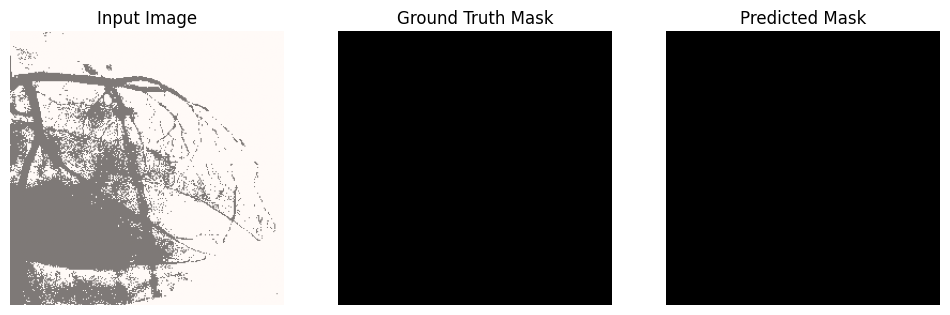

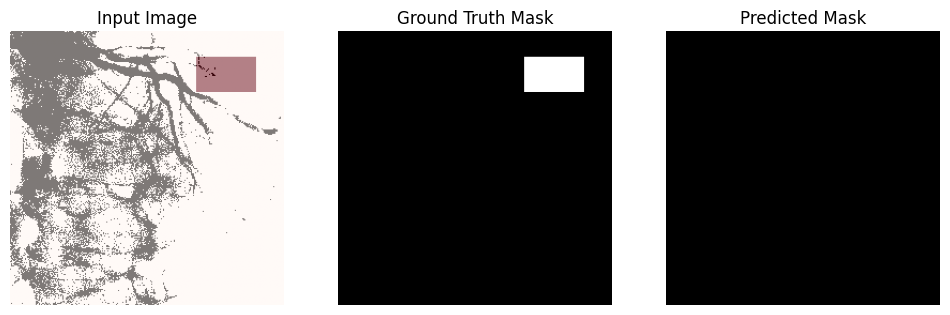

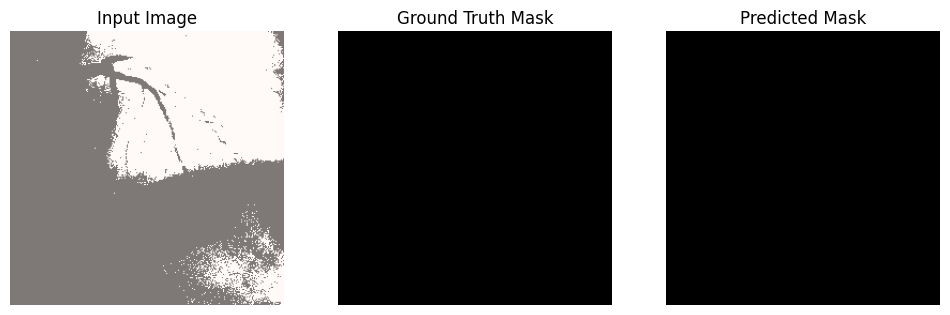

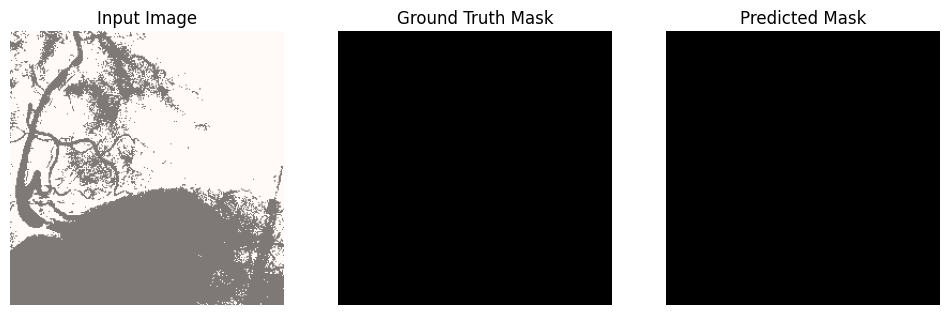

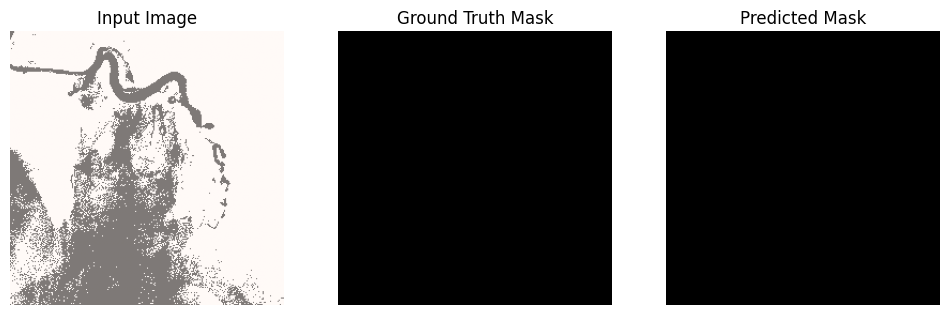

...

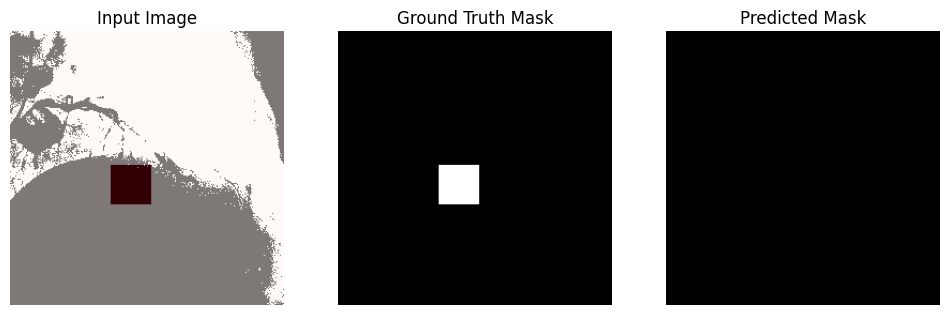

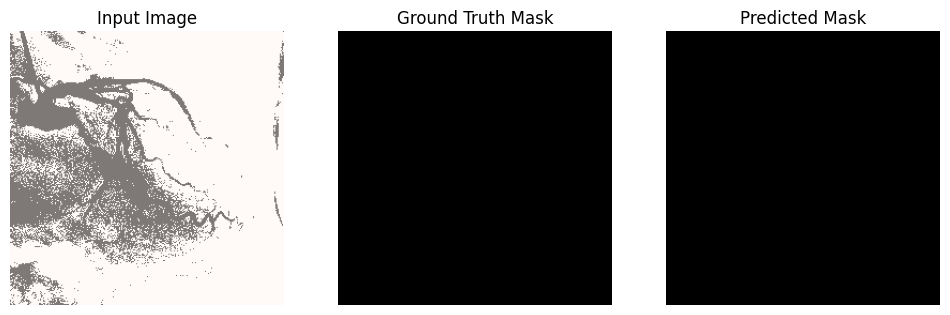

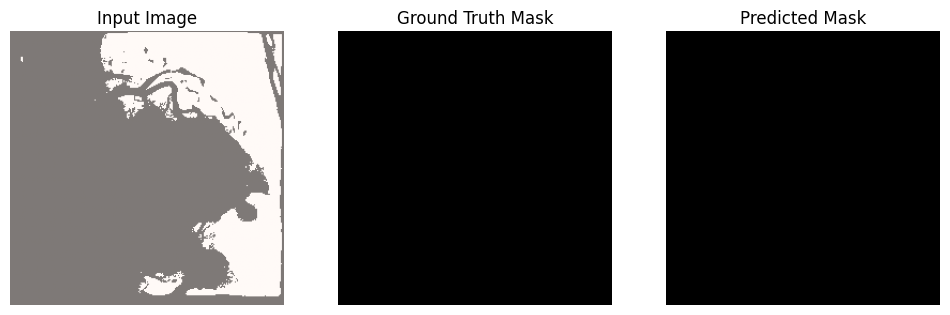

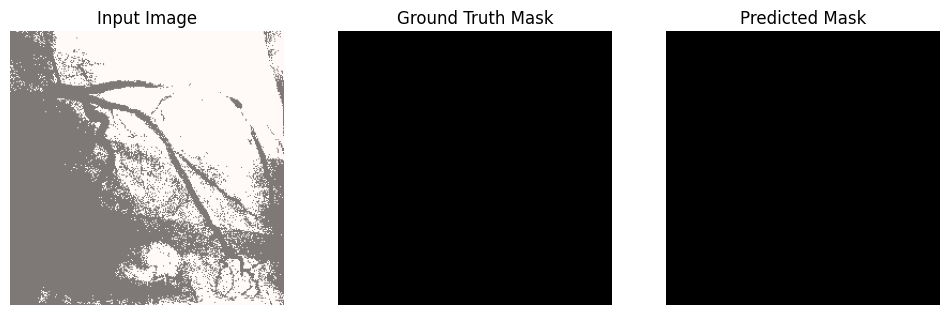

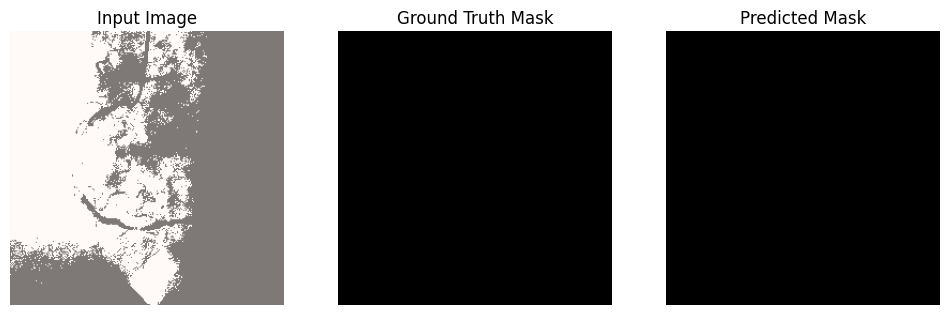

In [306]:
import matplotlib.pyplot as plt

# Suppose X_test_imgs = your test images
# y_test_masks = ground truth masks
# pred_masks = predicted masks (from CTM)

n_show = 187  # number of test images to visualize

for i in range(n_show):
    img = X_test_imgs[i]
    true_mask = y_test_masks[i]
    pred_mask = pred_masks[i]

    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 3, 1)
    plt.title("Input Image")
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.imshow(true_mask, cmap='Reds', alpha=0.5)
    plt.axis('off')

    # Ground truth mask
    plt.subplot(1, 3, 2)
    plt.title("Ground Truth Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    # Predicted mask
    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(pred_mask, cmap='gray')
    plt.axis('off')

    plt.show()

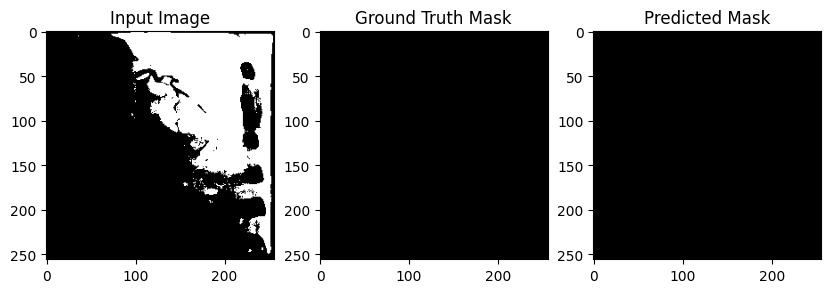

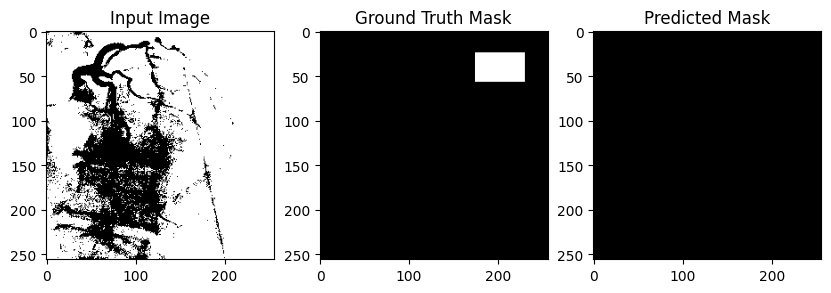

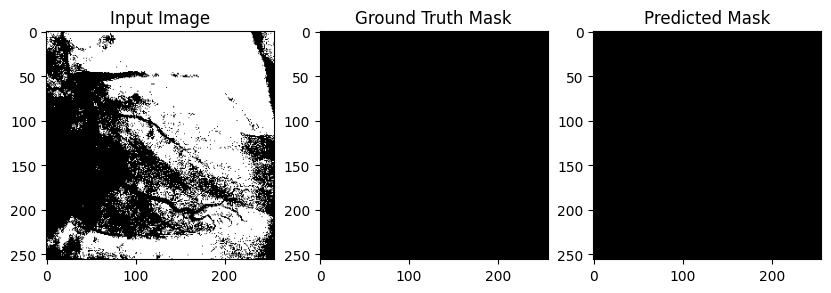

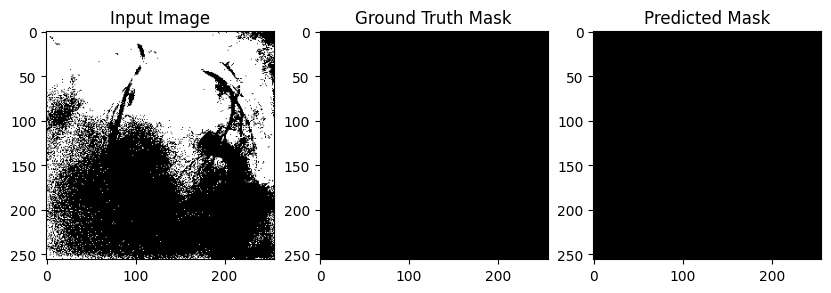

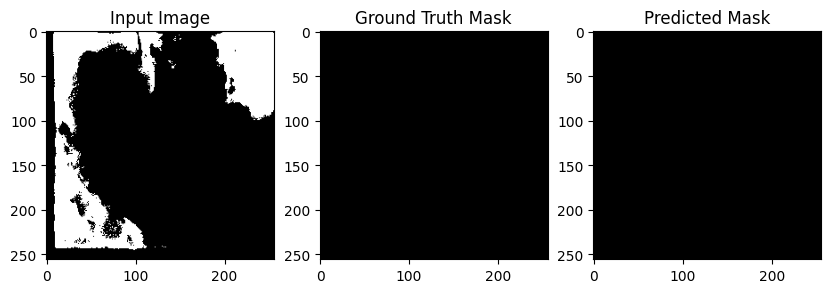

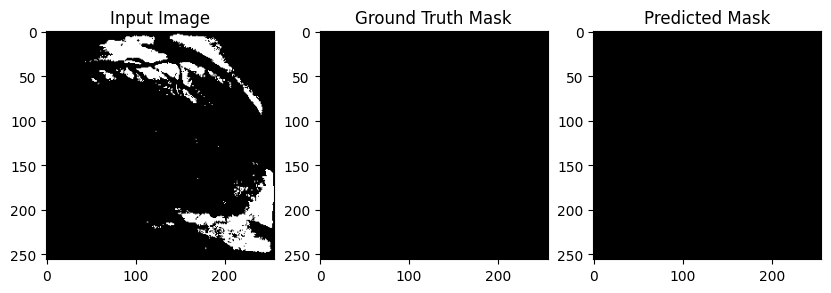

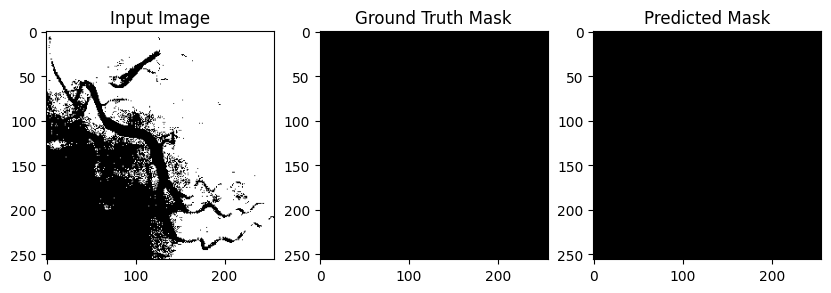

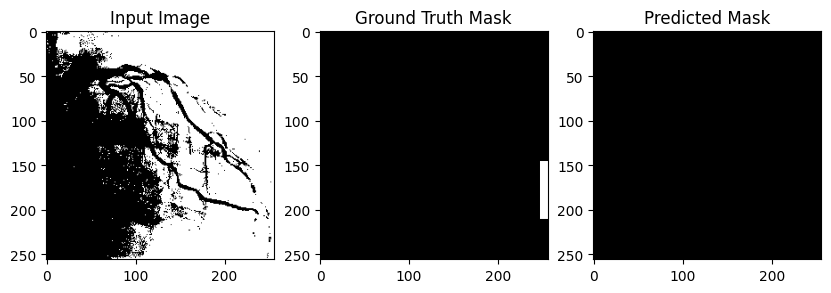

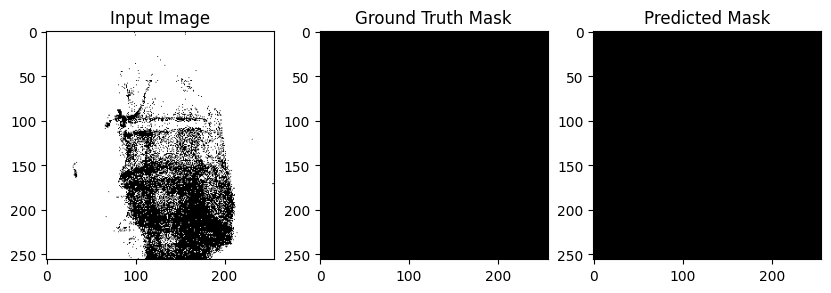

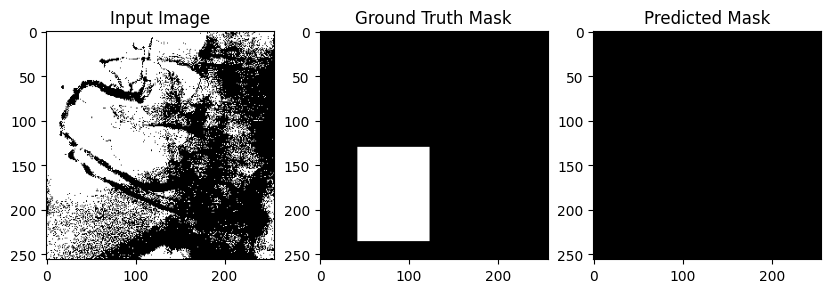

In [233]:
for i, test_image in enumerate(X_test_imgs[90:100]):
    test_mask = y_test_masks[i]
    test_patches = extract_patches_2d(test_image, patch_size)
    y_pred = tm.predict(test_patches)

    pred_patches = np.array([np.full(patch_size, label) for label in y_pred])
    pred_mask = reconstruct_from_patches_2d(pred_patches, test_image.shape)
    binary_pred_mask = (pred_mask > 0.5).astype(np.uint8)

    # Visualize
    plt.figure(figsize=(10,3))
    plt.subplot(1,3,1)
    plt.title("Input Image")
    plt.imshow(test_image, cmap='gray')
    plt.subplot(1,3,2)
    plt.title("Ground Truth Mask")
    plt.imshow(test_mask, cmap='gray')
    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(binary_pred_mask, cmap='gray')
    plt.show()